## IdentifyOptimalClusterNumber
This script:
- Loads the pickle file containing each image as an individual row with its embedding in a column
- Cluster analysis:
    - Test whether there is a structure within the embeddings that would allow them to be broken down into sub-clusters
        - Silhouette scores (are scores higher than 1?)
        - Elbow scores
        - Adjusted Rand Index
        - UMAP dimensionality reduction analysis
    - Decide on the optimal K
    - Run a K-mean cluster analysis with optimal K
    - Save a dataframe to a pickle file, containng for each image the cluster number it is assigned to, for various values of K
- Examine the distribution of images across the IMD ranking scale, within each cluster
- Plot a sample of images associated with each cluster number (for various values of K)
- Some testing of spatial plotting (to see whether the distribution of classes spatially is even or uneven)

In [1]:
import contextily as cx
import pickle
import os
import numpy as np
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point, LineString
import geopandas as gpd
import matplotlib.pyplot as plt
from functools import reduce
from math import ceil
from PIL import Image
import umap
import random
from sklearn.metrics import adjusted_rand_score
from sklearn.cluster import KMeans, MiniBatchKMeans
from functions import *

In [2]:
data_dir = os.path.join("../../../../data/embeddings/")
points_data_cache = data_dir + f"embeddings/one_row_per_image_cleaned.pkl"
with open(points_data_cache, "rb") as f:
    expanded_gdf = pickle.load(f)

# Test optimal cluster numbers

In [3]:
all_embeddings = np.stack(expanded_gdf['embedding'].values)

### Examine silhouette scores

In [15]:
best_k, inertias, sil_scores = find_optimal_k_silhoutte_fast(all_embeddings)
print(best_k)

2


In [16]:
# for n_clusters in range(2,20):
#     kmeans = KMeans(n_clusters=n_clusters, random_state=42)
#     labels = kmeans.fit_predict(all_embeddings)
#     silhouette_avg = silhouette_score(all_embeddings, labels)
#     print(f"{n_clusters}: Silhouette Score:", silhouette_avg)

### Examine elbow scores

In [17]:
optimal_k, ks, inertias = find_optimal_k_elbow(all_embeddings)
# # plot_elbow(ks, inertias, optimal_k)


Detected elbow at k = 7


### Plot together elbow and silhouette scores

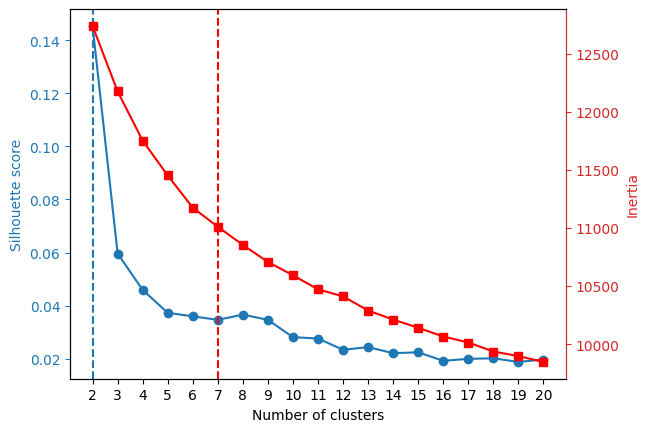

In [18]:
x = range(2, 21)

fig, ax = plt.subplots()

# First y-axis
ax.plot(x, sil_scores, marker='o')
ax.set_xlabel("Number of clusters")
ax.set_ylabel("Silhouette score")
ax.tick_params(axis='y')

ax.set_xticks(range(2, 21))

ax.axvline(optimal_k, linestyle='--', color='r')
ax.axvline(best_k, linestyle='--')


# Second y-axis
ax2 = ax.twinx()
ax2.plot(x, inertias, marker='s', color='r')
ax2.set_ylabel("Inertia")

# ---- Make second axis a different colour ----
axis_colour = "tab:red"

ax2.yaxis.label.set_color(axis_colour)
ax2.tick_params(axis='y', colors=axis_colour)
ax2.spines['right'].set_color(axis_colour)

# ---- Make second axis a different colour ----
axis_colour = "tab:blue"

ax.yaxis.label.set_color(axis_colour)
ax.tick_params(axis='y', colors=axis_colour)
ax.spines['right'].set_color(axis_colour)


### Assess clustering stability using the adjusted rand index

In [19]:
mean_aris = []
std_aris = []
for k in range(2,15):
    mean_ari, std_ari, _ = clustering_stability(all_embeddings, k)
    # print(f"k={k}: ARI = {mean_ari:.2f} ± {std_ari:.2f}")
    mean_aris.append(mean_ari)
    std_aris.append(std_ari)

Text(0, 0.5, 'ARI')

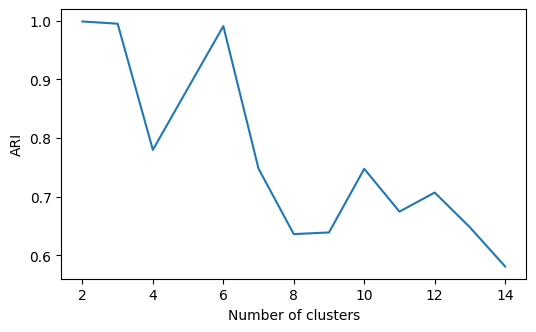

In [20]:
fig,ax=plt.subplots(figsize=(6,3.5))
ax.plot(range(2,15), mean_aris)
ax.set_xlabel("Number of clusters")
ax.set_ylabel("ARI")

# Run cluster analysis with optimal k
Add a column to the dataframe showing which cluster the image would fall within, for cluster numbers between 2 and 10

In [4]:
for k in range(2,11):
    #print(k)
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(all_embeddings)
    expanded_gdf[f'scene_cluster_{k}'] = labels + 1    

### Check UMAP low-dimensional projection

In [22]:
# embeddings = np.vstack(expanded_gdf["embedding"].values)   # shape (N, 512)
#              # string labels
# reducer = umap.UMAP(
#     n_neighbors=30, 
#     min_dist=0.1, 
#     metric='cosine',   # ✔ recommended for CLIP embeddings
#     random_state=42)

# emb_2d = reducer.fit_transform(embeddings)  # shape (N, 2)

# expanded_gdf['umap_x'] = emb_2d[:, 0]
# expanded_gdf['umap_y'] = emb_2d[:, 1]

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.


### Plot (this code is SLOW)

In [5]:
# ks = range(2, 11)  # k = 2 to 10
# n_plots = len(ks)
# ncols = 3
# nrows = int(np.ceil(n_plots / ncols))

# fig, axs = plt.subplots(nrows, ncols, figsize=(12, 4 * nrows))
# axs = axs.flatten()

# for i, k in enumerate(ks):
#     ax = axs[i]
#     labels = expanded_gdf[f'scene_cluster_{k}']

#     sc = ax.scatter(expanded_gdf['umap_x'], expanded_gdf['umap_y'], c=labels, cmap='tab10', s=8)
#     ax.set_title(f"k = {k}")
#     ax.set_xlabel("UMAP 1")
#     ax.set_ylabel("UMAP 2")

# # Turn off any unused axes
# for j in range(i + 1, len(axs)):
#     axs[j].axis('off')

# plt.tight_layout()
# plt.show()

### Save

In [24]:
expanded_gdf.to_pickle(data_dir + f"embeddings/one_row_per_image_cleaned_with_cluster_numbers.pkl")

In [6]:
# for num in range(1,8):
#     print(num)
#     print(len(expanded_gdf[expanded_gdf['scene_cluster_7']==num]))

### Check the images in each cluster

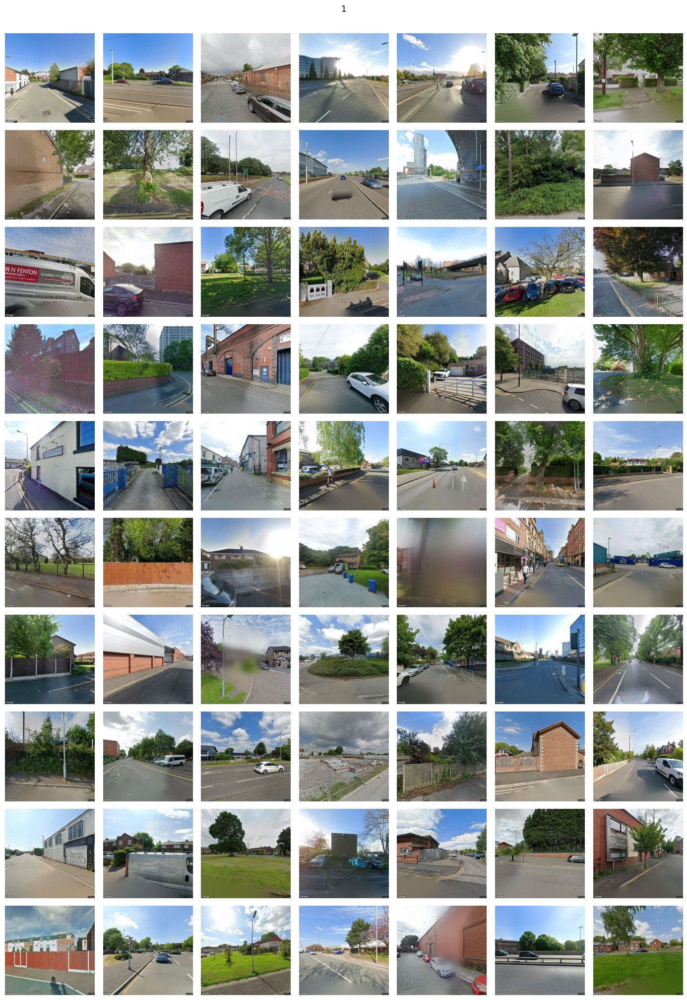

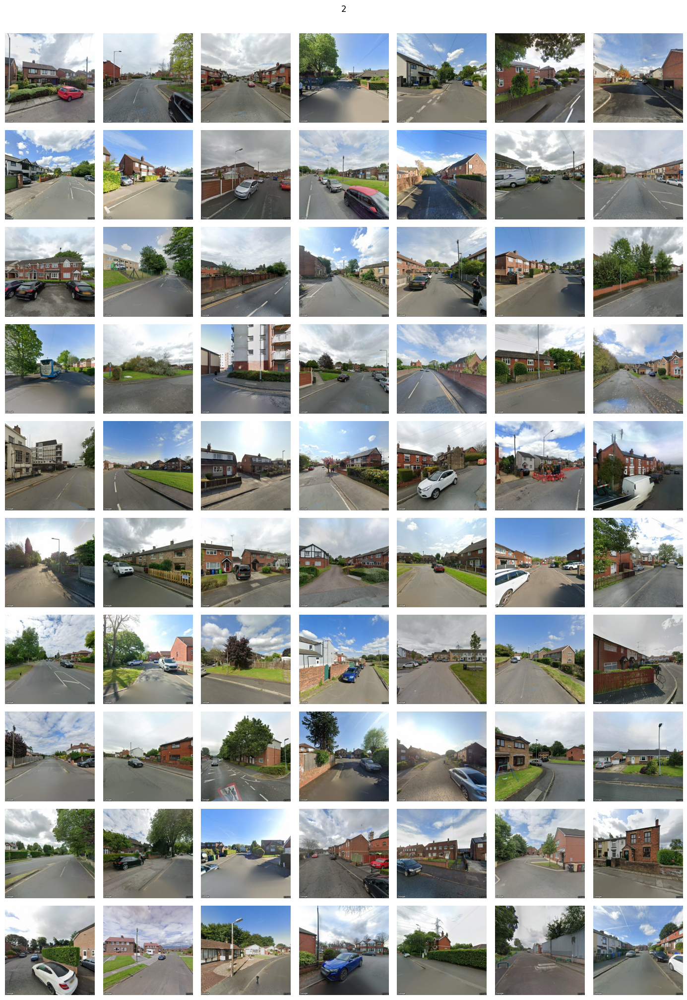

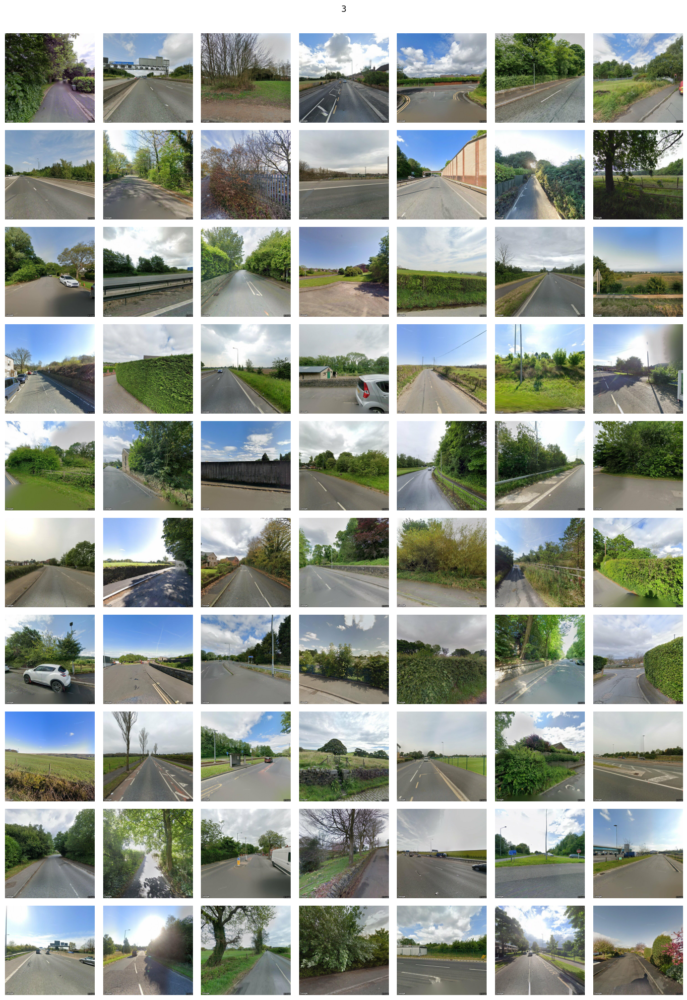

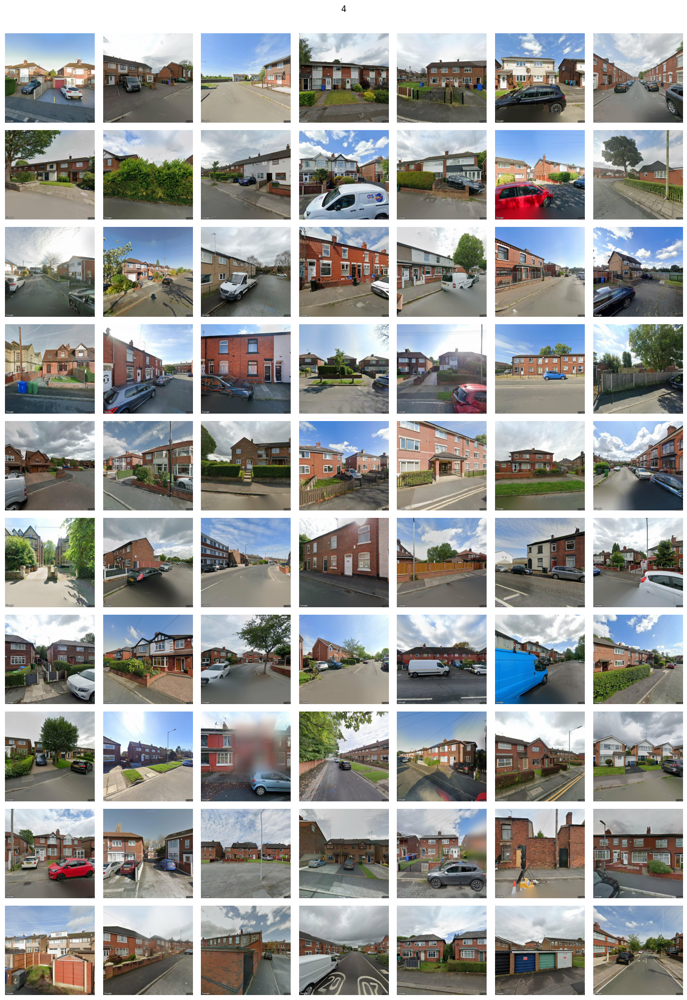

In [7]:
total_k = 4

for this_cluster_num in range(1,total_k+1):
# for this_cluster_num in [3]:    

    this_cluster = expanded_gdf[expanded_gdf[f"scene_cluster_{total_k}"]==this_cluster_num]

    image_files = this_cluster["image_files"].tolist()

    n_images = 70

    # Load images
    image_files_sample =random.sample(image_files, k=n_images)
    images = [Image.open(f) for f in image_files_sample]

    # Define grid size
    cols = 7  # number of columns in grid
    rows = ceil(n_images / cols)

    # Create figure
    fig, axes = plt.subplots(rows, cols, figsize=(cols*2, rows*2))
    axes = axes.flatten()

    # Plot images
    for ax, img in zip(axes, images):
        ax.imshow(img)
        ax.axis('off')

    # Turn off any extra axes
    for ax in axes[n_images:]:
        ax.axis('off')
        
    fig.suptitle(this_cluster_num, y=1.005)

    plt.tight_layout()
    plt.show()

## Examine distribution of images in each cluster across IMD ranks

In [104]:
imd_file = os.path.join("../../../../", "data", "imd", "File_2_-_IoD2025_Domains_of_Deprivation.xlsx")

imd = pd.read_excel(imd_file, sheet_name="IoD2025 Domains", header=0)

# Rename columns to simpler versions
imd_col_map = {"LSOA code (2021)": "LSOA21CD",
    "Index of Multiple Deprivation (IMD) Rank (where 1 is most deprived)": "imd_rank",
    "Index of Multiple Deprivation (IMD) Decile (where 1 is most deprived 10% of LSOAs)": "imd_decile"}
imd = imd.rename(columns=imd_col_map)

# Filter out only LSOAs in manchester (or in our dataset)
lsoa21cds = np.unique(expanded_gdf["LSOA21CD"])
imd_manc = imd[imd["LSOA21CD"].isin(lsoa21cds)].copy()

# Add a new reranked imd, just for manchester
imd_manc['imd_rerank'] = imd_manc['imd_rank'].rank(method='first').astype(int)

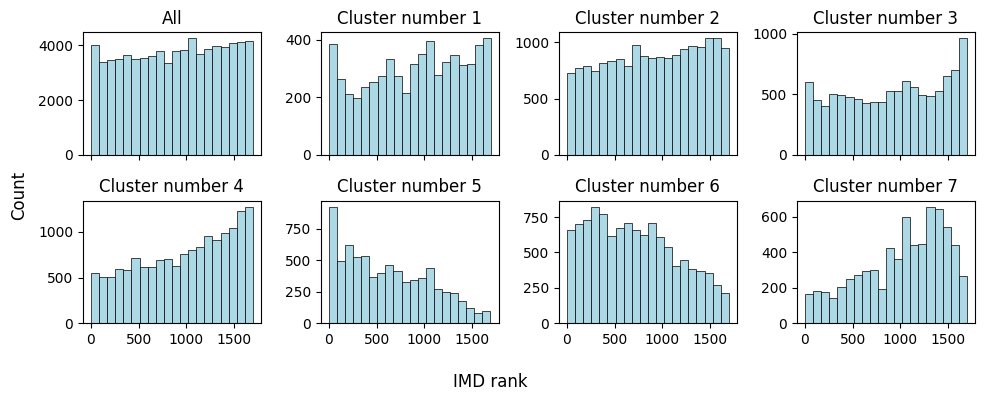

In [108]:
expanded_gdf_with_imd = pd.merge(left=expanded_gdf, right=imd_manc[['LSOA21CD', 'imd_rank', 'imd_rerank']], on="LSOA21CD")

imd_column = 'imd_rerank' #'imd_rank'

fig, axs = plt.subplots(ncols=4, nrows=2,sharex=True, sharey=False,figsize=(10, 4))
axs = axs.flatten()

axs[0].hist(expanded_gdf_with_imd[imd_column],bins=20,edgecolor="black",linewidth=0.5,color="lightblue")
axs[0].set_title("All")

for cluster_number in range(1, 8):
    cluster = expanded_gdf_with_imd[expanded_gdf_with_imd["scene_cluster_7"] == cluster_number]
    axs[cluster_number].hist(cluster[imd_column], bins=20, edgecolor="black",linewidth=0.5, color="lightblue")
    axs[cluster_number].set_title(f"Cluster number {cluster_number}")

# # Switch off any unused axes
# for ax in axs[7:]:
#     ax.axis("off")

# Global labels
fig.supxlabel("IMD rank")
fig.supylabel("Count")

plt.tight_layout()

## Spatial plots

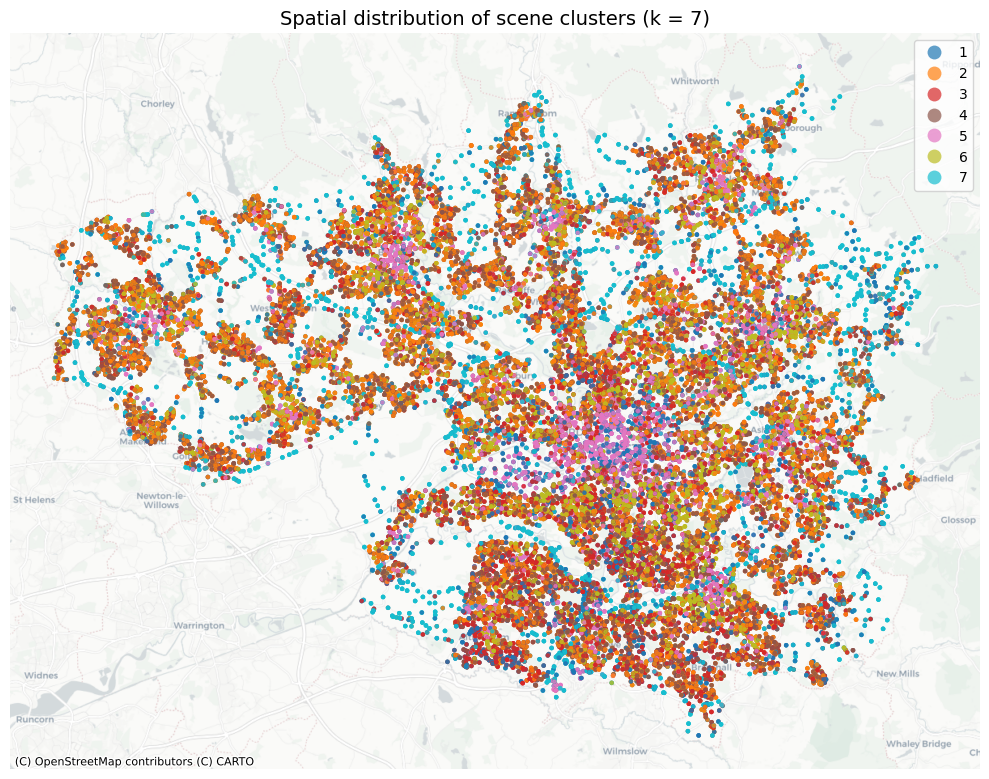

In [24]:
# Convert to GeoDataFrame
gdf = gpd.GeoDataFrame(
    expanded_gdf,
    geometry=gpd.points_from_xy(
        expanded_gdf.longitude,
        expanded_gdf.latitude),
    crs="EPSG:4326")#  # WGS84)
gdf = gdf.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(10, 10))

gdf.plot(
    ax=ax,
    column="scene_cluster_7",
    categorical=True,
    legend=True,
    markersize=5,
    alpha=0.7)

# Add basemap
cx.add_basemap(
    ax,
    source=cx.providers.CartoDB.Positron)

ax.set_axis_off()
ax.set_title("Spatial distribution of scene clusters (k = 7)", fontsize=14)

plt.tight_layout()
plt.show()

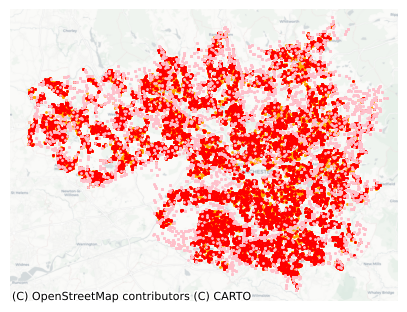

In [25]:
gdf_all = gdf.to_crs(epsg=3857)

fig, axs = plt.subplots(figsize=(5, 5))

colours = [ 'orange',  'red', 'pink']

for ax_num, cluster_num in enumerate([2,4,7]):
    # Keep only this cluster 
    this_cluster = gdf[gdf["scene_cluster_7"] == cluster_num]

    # Reproject for basemap
    this_cluster = this_cluster.to_crs(epsg=3857)

    # gdf_all.plot(ax=axs[ax_num], color="lightgrey", markersize=3, alpha=0.3)
    this_cluster.plot(ax=axs, color = colours[ax_num], markersize=1)
    cx.add_basemap(axs, source=cx.providers.CartoDB.Positron)

    axs.set_axis_off()
    # plt.show()


In [ ]:
# gdf_all = gdf.to_crs(epsg=3857)

# fig, axs = plt.subplots(ncols=2, nrows=4, figsize=(10, 15))
# axs=axs.flatten()

# colours = ['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink']

# for ax_num, cluster_num in enumerate(range(1,8)):
#     # Keep only this cluster 
#     this_cluster = gdf[gdf["scene_cluster_7"] == cluster_num]

#     # Reproject for basemap
#     this_cluster = this_cluster.to_crs(epsg=3857)


#     # gdf_all.plot(ax=axs[ax_num], color="lightgrey", markersize=3, alpha=0.3)
#     this_cluster.plot(ax=axs[ax_num], color = colours[ax_num], markersize=3)
#     print(len(this_cluster))
#     cx.add_basemap(axs[ax_num], source=cx.providers.CartoDB.Positron)

#     axs[ax_num].set_axis_off()
#     # plt.show()